# Evaluating Gene Correlations - First heart field

In [47]:
import numpy as np
import anndata
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import time
import os
import scanpy as sc
import sklearn.metrics
import seaborn as sns
import scipy
import scvelo as scv
from scipy import stats
import mplscience

import matplotlib
from scipy.spatial import cKDTree
import sys
sys.path.append('/home/icb/manuel.gander/Reproducibility_TOME/Utils')

# Utils contains some functions I use a lot
import Utils

#sc.settings.verbosity = 0

In [2]:
Path="/home/icb/manuel.gander/Reproducibility_TOME/Data"

# Define time points
t=[3.5, 4.5, 5.25, 5.5]+[6.25+x/4 for x in range(0,10)]+[8.5]+[9.5+x for x in range(0,5)]
ts=[str(a) for a in [3.5, 4.5, 5.25, 5.5, 6.25]] + [str(a) for a in np.arange(6.5, 8.5, 0.25)] + ['8.5a', '8.5b']+ [str(a) for a in np.arange(9.5, 14.5, 1)]
ts=['E'+a for a in ts]


t2=[3.5, 4.5, 5.25, 5.5]+[6.25+x/4 for x in range(0,10)]+[9.5+x for x in range(0,5)]

# Growth of embryo:
#    - cells corresponds to the estimated total amount of cells in the embryo for each time point
#    - av_g corresponds to the average grwoth rate of the embryo at each specific time point
cells=[32, 80, 100, 120, 400, 660, 1720, 4500, 8200, 15000, 30000, 60000, 73000, 90000, 200000, 1100000, 2600000, 6000000, 13000000 ]
av_g=np.zeros(len(t2)-1)
for i in range(0,len(av_g)):
    av_g[i]=cells[i+1]/cells[i]/(t2[i+1]-t2[i])

# Load anndatas and maps

In [3]:
i=7

ts0=ts[i]
print(ts0)
ts1=ts[i+1]

(A0,  A1)=Utils.load_adata(ts0, ts1)

adata=A0.concatenate(A1, join='outer', index_unique=None)

E7.0


In [5]:
eps=0.01

no_gr=False

Dict0=np.load(f"{Path}/TOME-maps/Gene_cor_apop_{ts0}.npy", allow_pickle=True)
Dict0 = dict(enumerate(Dict0.flatten(), 1))[1]

if no_gr:
    Dict1=np.load(f"{Path}/Moscot-maps/Map_{ts0}_{ts1}_{eps}_giv_lam_no_gr.npy", allow_pickle=True)
else:
    Dict1=np.load(f"{Path}/Moscot-maps/Map_{ts0}_{ts1}_{eps}_giv_lam.npy", allow_pickle=True)

Dict1 = dict(enumerate(Dict1.flatten(), 1))[1]

In [6]:
gT=Dict0['g']
gT=gT/gT.mean()*cells[i+1]/cells[i]
gM=Dict1['gr']
gM=gM/gM.mean()*cells[i+1]/cells[i]

In [7]:
zT=np.zeros(len(adata))
zT[:len(gT)]=gT
adata.obs['Pull_TOME']=zT

zM=np.zeros(len(adata))
zM[:len(gM)]=gM
adata.obs['Pull_Moscot']=zM

In [8]:
ct='Definitive endoderm'
eps=0.01


gT=np.load(f"{Path}/TOME-maps/Gene_cor_{ts0}_{ct}.npy", allow_pickle=True)
gM=np.load(f"{Path}/Moscot-maps/Gene_cor_{ts0}_{ct}_{eps}.npy", allow_pickle=True)
gT = dict(enumerate(gT.flatten(), 1))[1]['g']
gM = dict(enumerate(gM.flatten(), 1))[1]['g']


gT=gT/gT.sum()*len(A1[A1.obs['cell_type']==ct])*cells[11]/cells[10]
gM=gM/gM.sum()*len(A1[A1.obs['cell_type']==ct])*cells[11]/cells[10]

zT=np.zeros(len(adata))
zT[:len(gT)]=gT
adata.obs['Def_endo_pull_TOME']=zT

zM=np.zeros(len(adata))
zM[:len(gM)]=gM
adata.obs['Def_endo_pull_Moscot']=zM

# Visualize both pulls

In [9]:
mplscience.set_style(reset_current=True)
sc.set_figure_params(scanpy=True, dpi=100, frameon=True, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)

In [10]:
sc.pp.neighbors(adata, n_neighbors=15, use_rep='X_pcaS')

In [11]:
sc.tl.umap(adata, random_state=4)

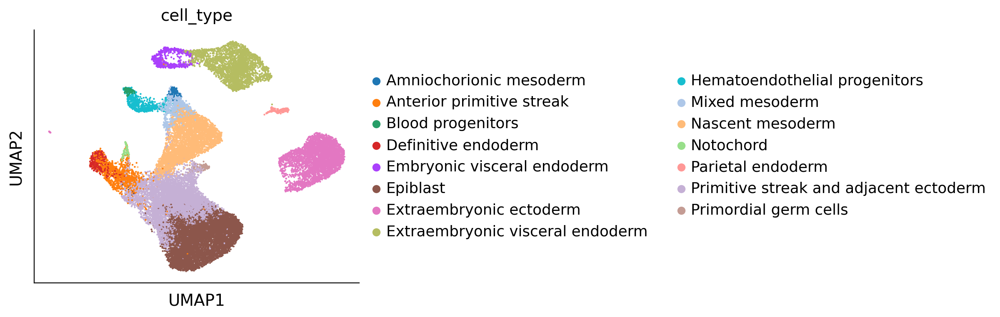

In [12]:
sc.pl.umap(adata, color='cell_type', size=10)

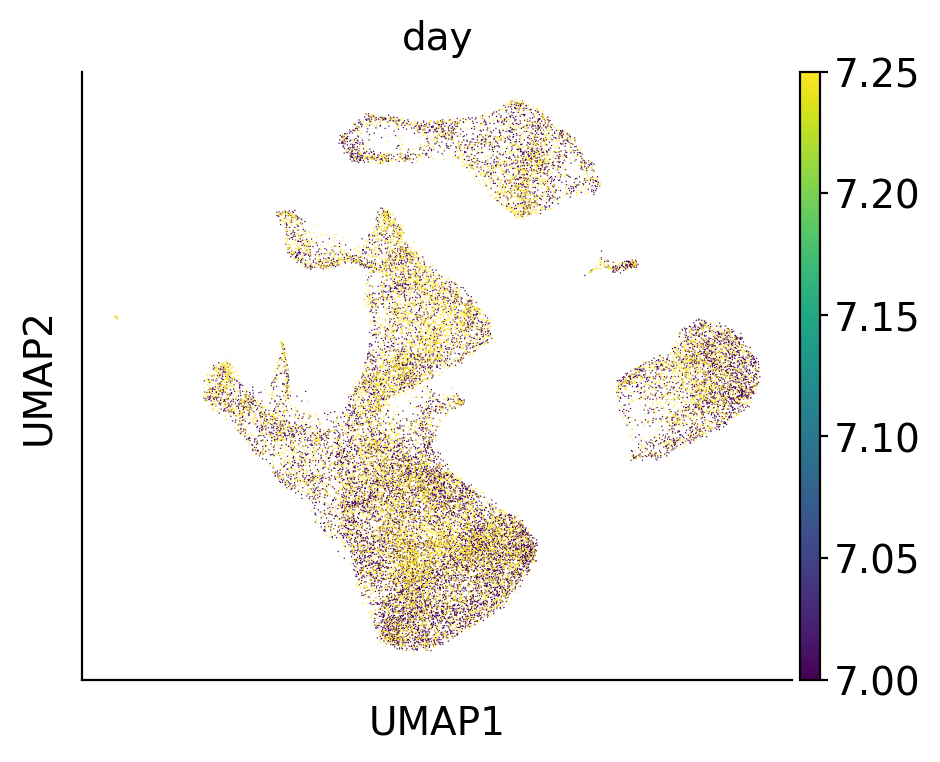

In [13]:
sc.pl.umap(adata, color='day', size=1)

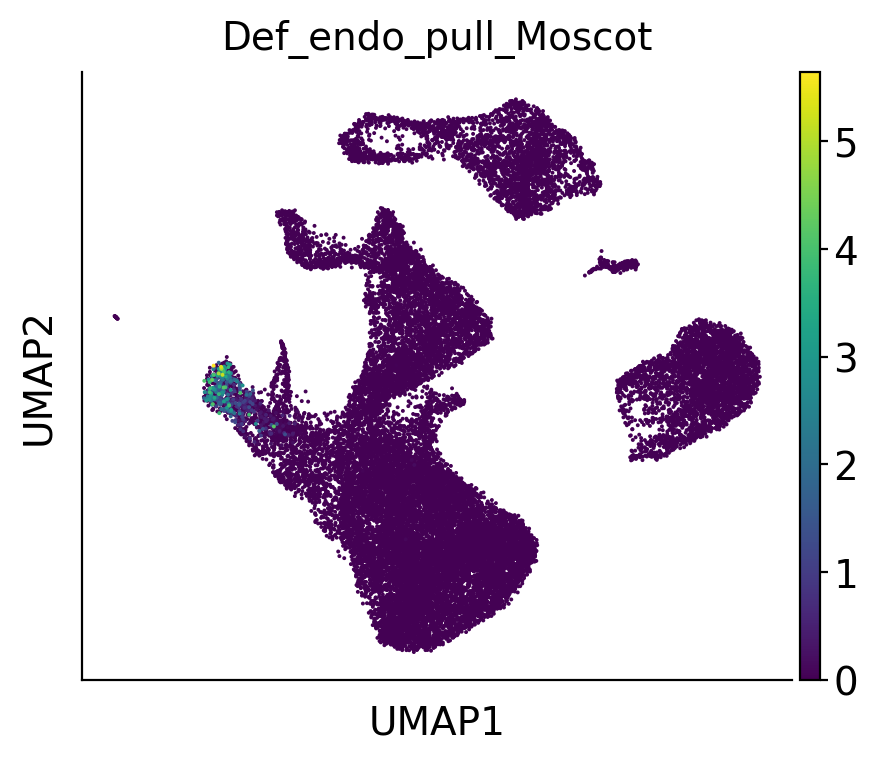

In [14]:
sc.pl.umap(adata, color='Def_endo_pull_Moscot', size=8)

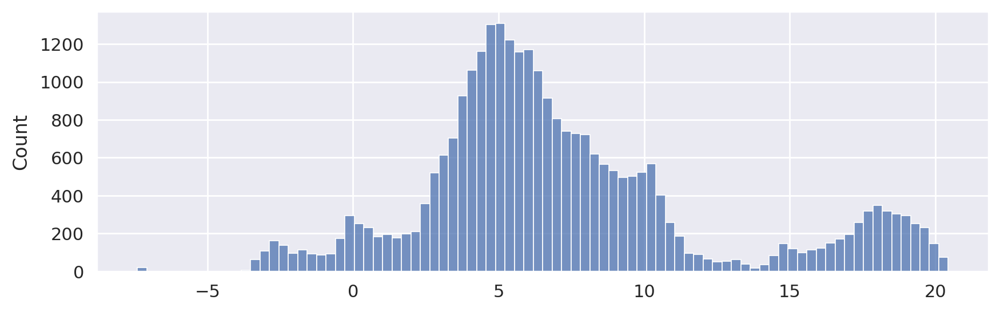

In [15]:
# Exclude Extraembryonic ectoderm outlier cells
sns.set(rc={'figure.figsize':(10,3)})
sns.histplot(data=adata.obsm['X_umap'][:,0])
adata2=adata[adata.obsm['X_umap'][:,0]>-5].copy()

In [16]:
# Mirror umap at identity so that Definitve endoderm is down there, which makes the figure nicer
umap=adata2.obsm['X_umap'].copy()
adata2.obsm['X_umap'][:,0]=umap[:,1]
adata2.obsm['X_umap'][:,1]=umap[:,0]

In [17]:
E7_cts=[]
for i in set(adata.obs['cell_state']):
    if i[:3]=='E7:':
        E7_cts.append(i)

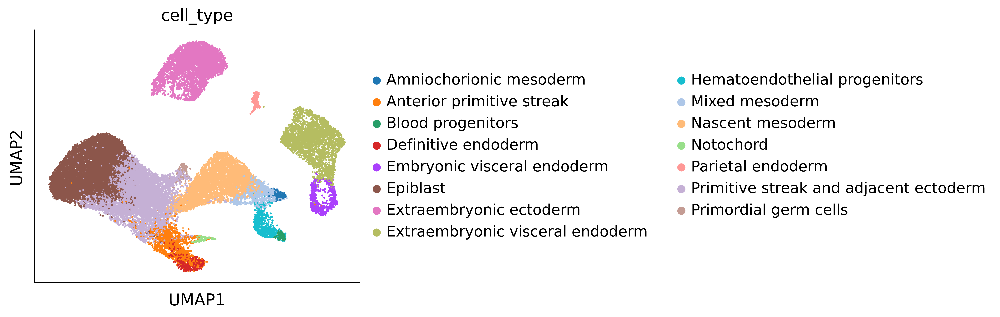

In [18]:
mplscience.set_style(reset_current=True)
sc.set_figure_params(scanpy=True, dpi=300, frameon=True, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)
sc.pl.umap(adata2, color='cell_type', size=12)

In [19]:
E7_cts=[]
for i in set(adata2.obs['cell_state']):
    if i[:3]=='E7:':
        E7_cts.append(i)

v=[]
for i in range(len(adata2)):
    a=adata2.obs['cell_state'].iloc[i]
    if a in E7_cts:
        v.append(a[3:])
    else:
        v.append('Z_E7.25 cells')
adata2.obs['E7_cells']=v

# The umap

In [20]:
# Sort so that E7.25 cells are plotted last
adata2.obs['ar']=np.arange(len(adata2))
ar=adata2.obs.sort_values('day', ascending=False)['ar']
adata3=adata2[ar].copy()

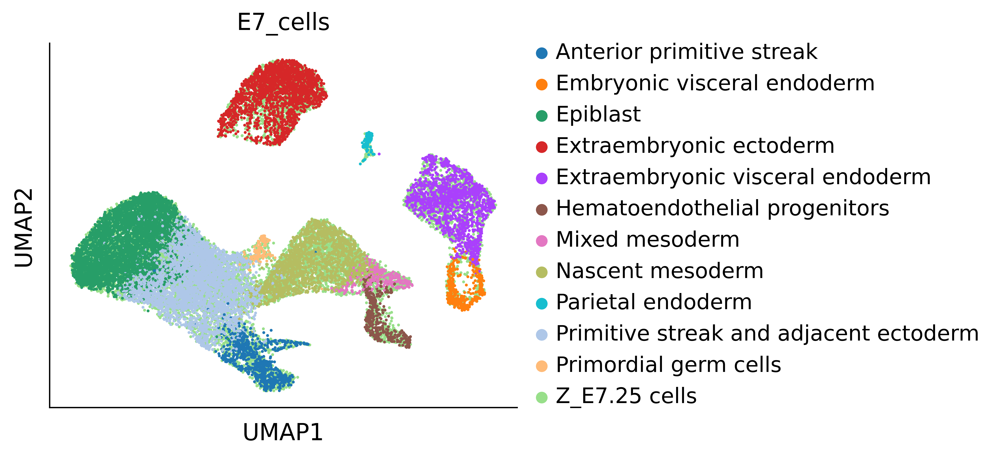

In [21]:
sc.pl.umap(adata3, color='E7_cells', size=12)

In [22]:
def change_pal_order(pal,i,j):
    paln=pal.copy()
    paln[i]=pal[j]
    paln[j]=pal[i]
    return(paln)

pal=sns.color_palette('colorblind')
pal.append(np.array([80, 200, 120])/256)
pal.append(np.array([200, 200, 200])/256)
pal=change_pal_order(pal,0,2)
pal=change_pal_order(pal,0,3)
pal=change_pal_order(pal,0,7)
pal=change_pal_order(pal,1,9)
#pal[0]=np.array([120, 110, 30])/256
#pal=change_pal_order(pal,0,1)
pal=change_pal_order(pal,0,6)

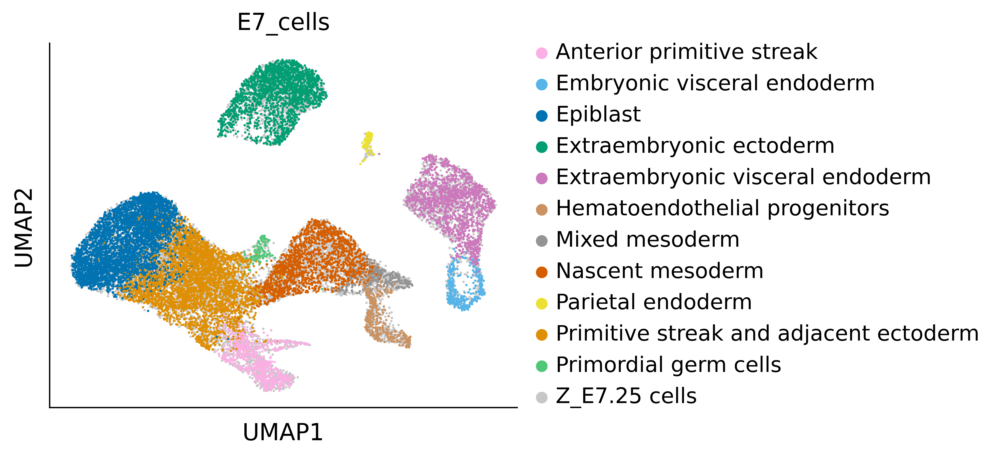

In [23]:
sc.pl.umap(adata3, color='E7_cells', size=8, palette=pal)

In [24]:
mplscience.set_style(reset_current=True)
sc.set_figure_params(scanpy=True, dpi=300, frameon=True, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)

# The legend

In [25]:
pal.append(pal[-1])
pal[-2]=np.array([1,1,1])

In [26]:
selected_cell_types=['Epiblast', 'Nascent mesoderm',
                     'Primitive streak and adjacent ectoderm', 'Extraembryonic ectoderm']

In [27]:
# Add empty cell type, for spacing in the legend

In [28]:
v=[]
l=0
for i in range(len(adata3)):
    if l==0:
        v.append('token')
        l=1
    else:
        v.append(adata3.obs['E7_cells'].iloc[i])
adata3.obs['ct_legend']=v
adata3.obs['ct_legend']=adata3.obs['ct_legend'].astype('category')

In [29]:
cats=adata3.obs['ct_legend'].cat.categories

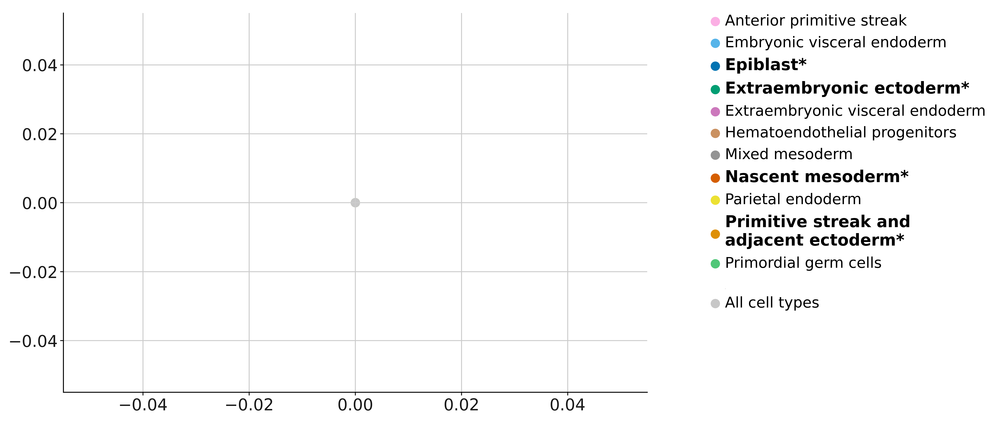

In [30]:
fig, ax = plt.subplots(figsize=(9, 6), dpi=300)
for i in range(len(cats)):
    ct=cats[i]
    ax.scatter(0, 0, label=ct, s=50, color=pal[i], alpha=1)
    
legend = ax.legend(loc=(1.1,0.2))

# Iterate over texts.
# Method names are quite self-describing
for text in legend.get_texts():
    cell_type=str(text).split(', ')[2][1:-2]
    if cell_type=='Z_E7.25 cells':
        text.set_text("_")
        text.set_fontsize(1)
        
    if cell_type=='token':
        text.set_text("All cell types")
        
    if cell_type in selected_cell_types:
        if cell_type=='Primitive streak and adjacent ectoderm':
            text.set_text("Primitive streak and \nadjacent ectoderm*")
        else:
            text.set_text(cell_type+'*')
        text.set_fontweight("bold")
        text.set_fontsize(14)
        
#legend.legendHandles[11]._sizes = [300]

# Growth rate umaps

In [31]:
sc.set_figure_params(scanpy=True, dpi=300, frameon=False, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)

In [32]:
adata4=adata3[adata3.obs['day']==7.0]

In [33]:
mplscience.set_style(reset_current=True)
sc.set_figure_params(scanpy=True, dpi=300, frameon=False, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)

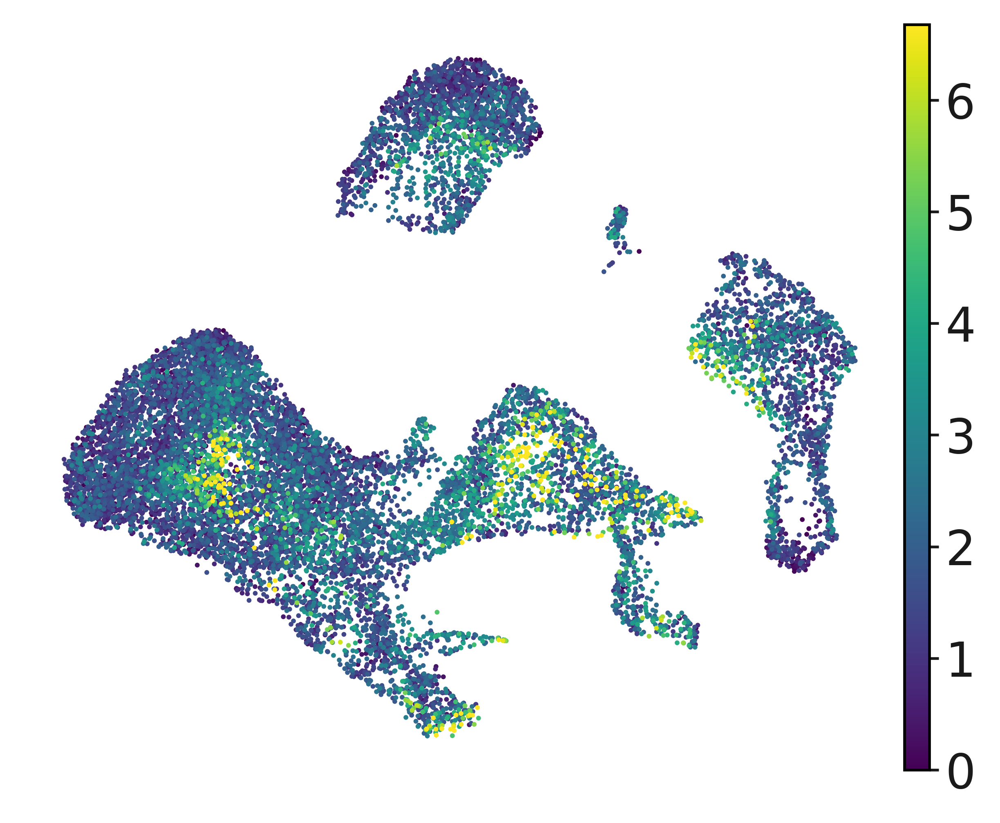

In [34]:
perc=99

vmax=np.sort(list(adata4.obs['Pull_TOME']))[int(len(adata4)*perc/100)]

sc.pl.umap(adata4, color='Pull_TOME', title='', vmax=vmax, size=8, legend_fontsize=10)

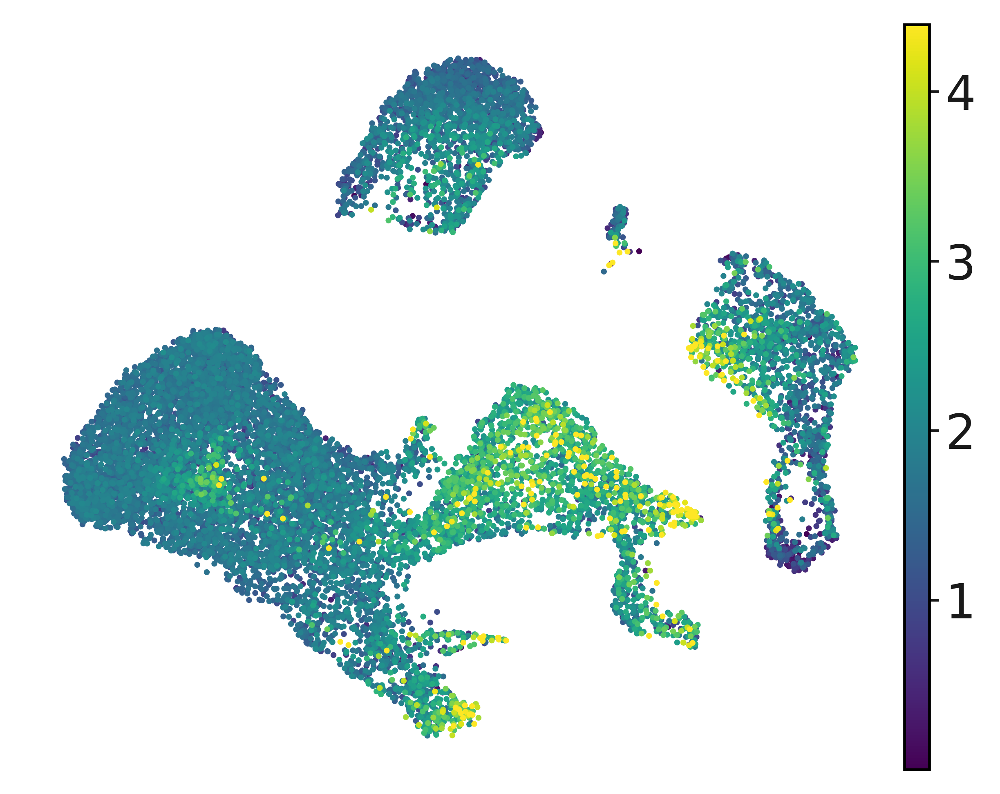

In [35]:
perc=99

vmax=np.sort(list(adata4.obs['Pull_Moscot']))[int(len(adata4)*perc/100)]

sc.pl.umap(adata4, color='Pull_Moscot', title='', vmax=vmax, size=12, legend_loc=None, legend_fontsize=10)

# Umaps for gene correlation

In [36]:
#pal=sns.color_palette('colorblind')
#pal[0]=pal[-1]
pal[1]=np.array([142, 70, 36])/256
pal[2]=np.array([200, 200, 200])/256

mplscience.set_style(reset_current=True)
sc.set_figure_params(scanpy=True, dpi=800, frameon=False, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)

In [37]:
A0=adata2[adata2.obs['day']==7]
Ade=adata2[adata2.obs['cell_type']=='Definitive endoderm']
Ac=A0.concatenate(Ade)

<AxesSubplot:ylabel='Count'>

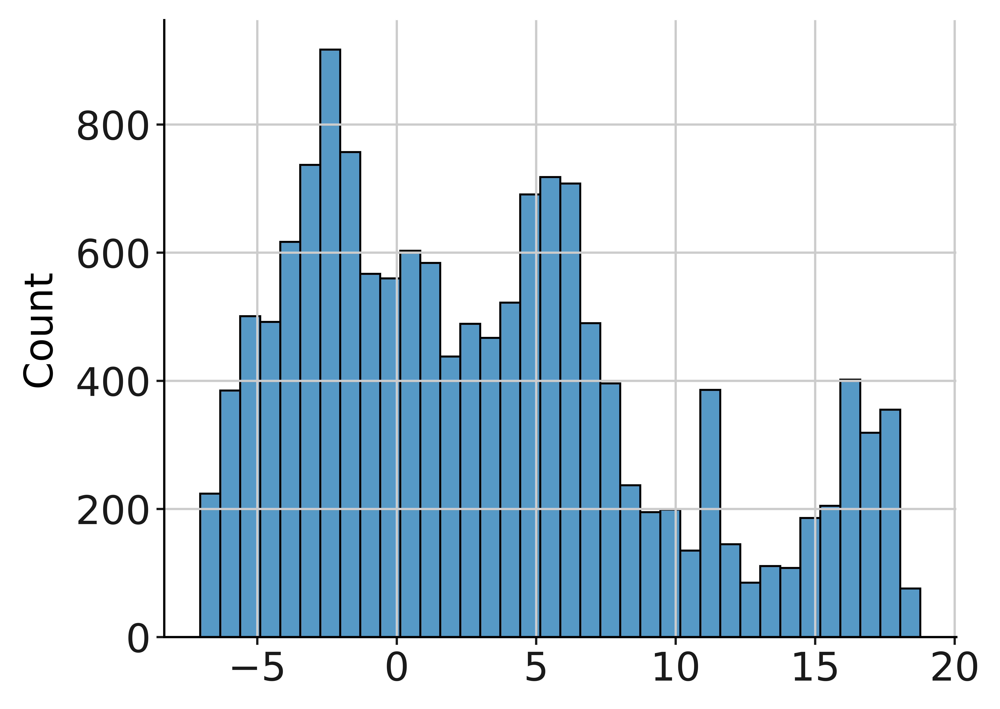

In [38]:
sns.histplot(Ac.obsm['X_umap'][:,0])

<AxesSubplot:ylabel='Count'>

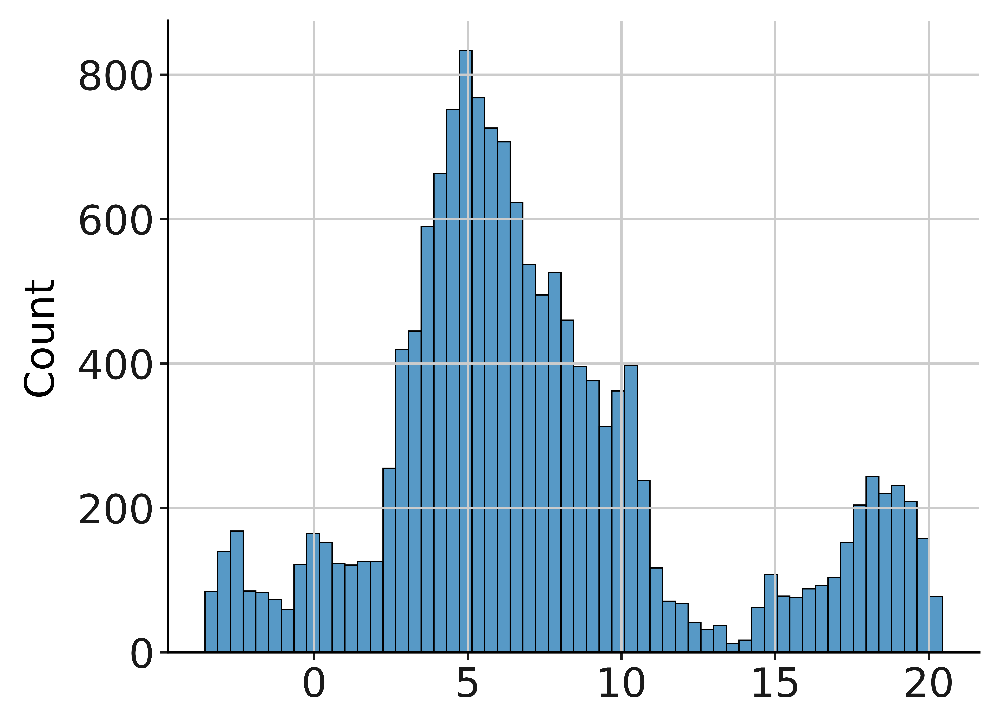

In [39]:
sns.histplot(Ac.obsm['X_umap'][:,1])

In [40]:
v=[]
order=[]
for i in range(len(Ac)):
    ct=Ac.obs['cell_state'].iloc[i]
    
    if ct=='E7.25:Definitive endoderm':
        v.append('Definitive endoderm (E7.25)')
        order.append(2)
    
    elif ct=='E7:Anterior primitive streak':
        v.append('Anterior primitive streak (E7.0)')
        order.append(2)
    else:
        v.append('Other cell type')
        order.append(0)
Ac.obs['def_endo']=v
Ac.obs['def_endo']=Ac.obs['def_endo'].astype('category')
Ac.obs['order']=order
ar=np.arange(len(Ac))
np.random.shuffle(ar)
Ac.obs['ar']=ar
Acs=Ac[list(Ac.obs.sort_values('order')['ar'])]

In [41]:
sc.pl.umap(Acs, color='def_endo', size=4, palette=pal)

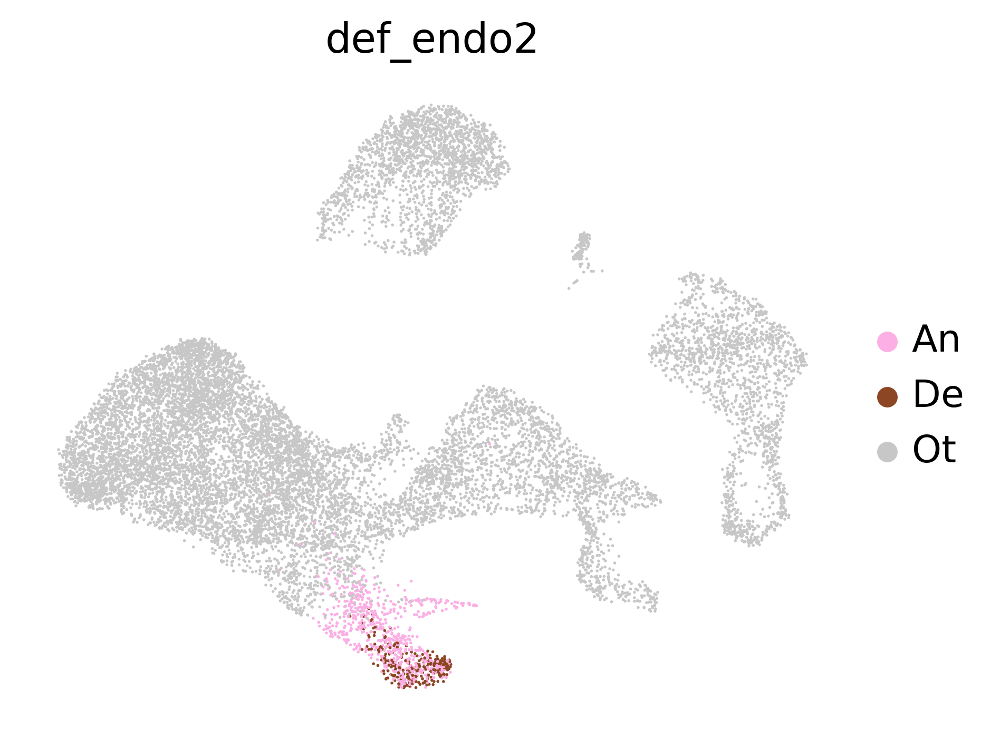

In [46]:
Acs.obs['def_endo2']=[a[:2] for a in Acs.obs['def_endo']]
sc.pl.umap(Acs, color='def_endo2', size=4, palette=pal)

In [45]:
mplscience.set_style(reset_current=True)
sc.set_figure_params(scanpy=True, dpi=200, frameon=False, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)

v=[]
stages=list(A.obs['cell_state'])
for i in range(len(A)):
    ct=stages[i]
    if ct=='E7:Anterior primitive streak':
        v.append(1)
    elif ct=='E7.25:Definitive endoderm':
        v.append(2)
    else:
        v.append(0)
A.obs['ord']=v
inds=A.obs.sort_values('ord').index
B=A[inds]
s=[4 if a in ['E7.25:Definitive endoderm', 'E7:Anterior primitive streak'] else 2 for a in B.obs['cell_state']]
B.obs['def_endo2']=[a[0] for a in B.obs['def_endo']]
sc.pl.umap(B, color='def_endo2', size=s, palette=pal)

NameError: name 'A' is not defined

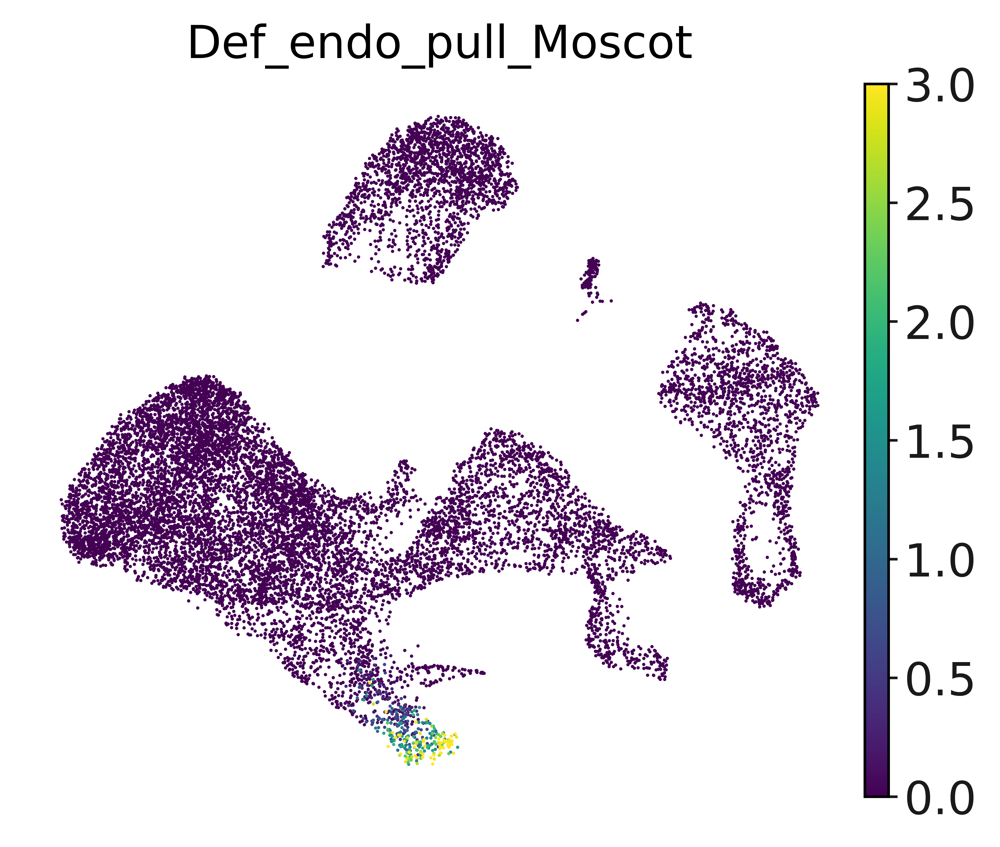

In [43]:
A0=Acs[Acs.obs['day']==7]
sc.pl.umap(A0, color='Def_endo_pull_Moscot', size=4, vmax=3)

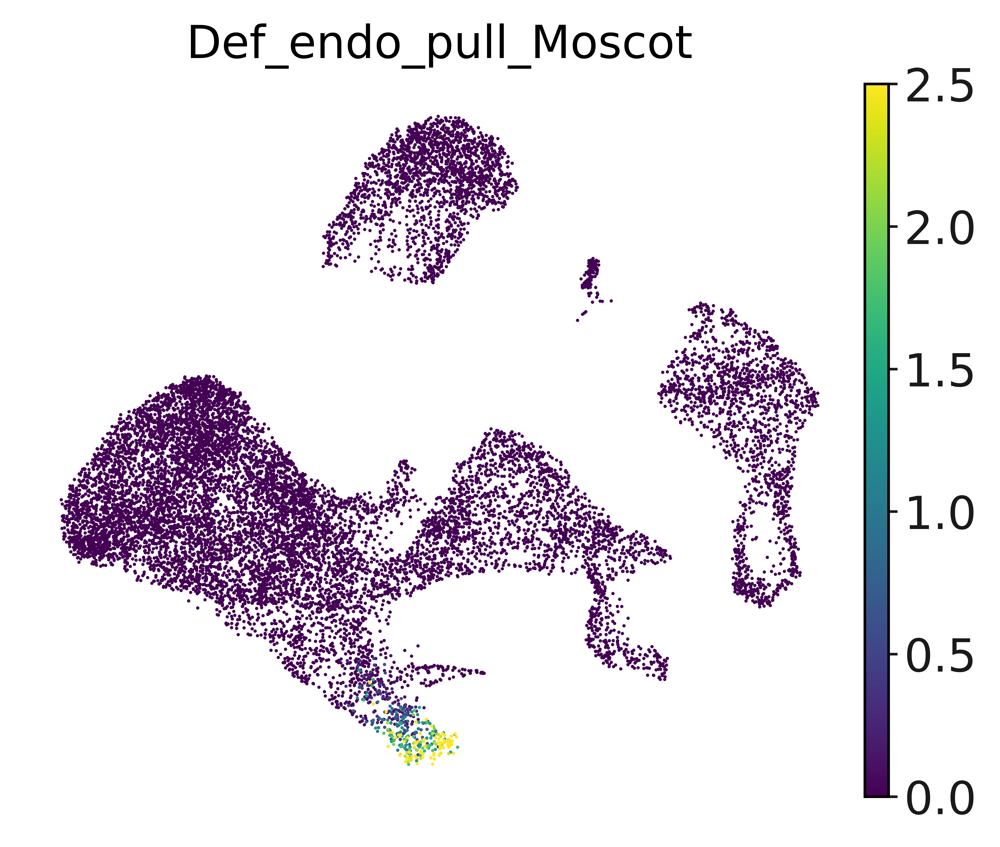

In [44]:
A0=Acs[Acs.obs['day']==7]
sc.pl.umap(A0, color='Def_endo_pull_Moscot', size=4, vmax=2.5)

# Correlation for curated genes

The following list of genes was obtained by litarture seach when looking for genes that predict deveopment into first heart field cells. The key in the dictionary corresponds to the citation (Pubmed ID), and the values correspond to the genes the publication lists.

In [48]:
adataS=sc.read(f"{Path}/anndatas/scvi_adata_{ts0}_DE.h5ad")
adataS.var.index=[a for a in adataS.var['gene_names']]
adataS.obsm['X_umap']=adata[adata.obs['day']==7].obsm['X_umap']

In [49]:
# from the umaps:
genes=['Smad3', 'Gata6', 'Fgf8', 'Tdgf1', 'Sox17', 'Cldn6',  'Otx2', 'Irx3', 
       'Dkk1', 'Tbx1', 'Lhx1', 'Hhex', 'Gata4', 'Cer1', 'Irx1', 'Amot', 'Ihh', 'Hnf1b']

In [50]:
subset=True

DF=pd.DataFrame({})

for gene in genes:
    if gene in [a for a in adataS.var.index]:

        loc=adataS.var.index.get_loc(gene)
        exp=adataS.layers['scvi_normalized'][:,loc]
        #exp=adataS.X[:,loc]
        #exp=np.array(exp.todense()).T[0]
        
        if subset==True:
            wh=np.where(adataS.obs['cell_state']=='E7:Anterior primitive streak')[0]
            exp=exp[wh]
            gT2=gT[wh]
            gM2=gM[wh]
        else:
            gT2=gT.copy()
            gM2=gM.copy()

        (cor, p)=scipy.stats.spearmanr(exp, gT2)
        dfT=pd.DataFrame({'Timepoint': ts0, 'Gene':[gene], 'Method': 'TOME', 'Correlation':cor, 'P-value':p, 'type':'Spearman'})
        (cor, p)=scipy.stats.spearmanr(exp, gM2)
        dfM=pd.DataFrame({'Timepoint': ts0, 'Gene':[gene], 'Method': 'moscot', 'Correlation':cor, 'P-value':p, 'type':'Spearman'})
        DF=pd.concat([DF, dfT,dfM])
DF['Abs. Correlation']=abs(DF['Correlation'])
DF.index=np.arange(len(DF))

<AxesSubplot:xlabel='Correlation', ylabel='Timepoint'>

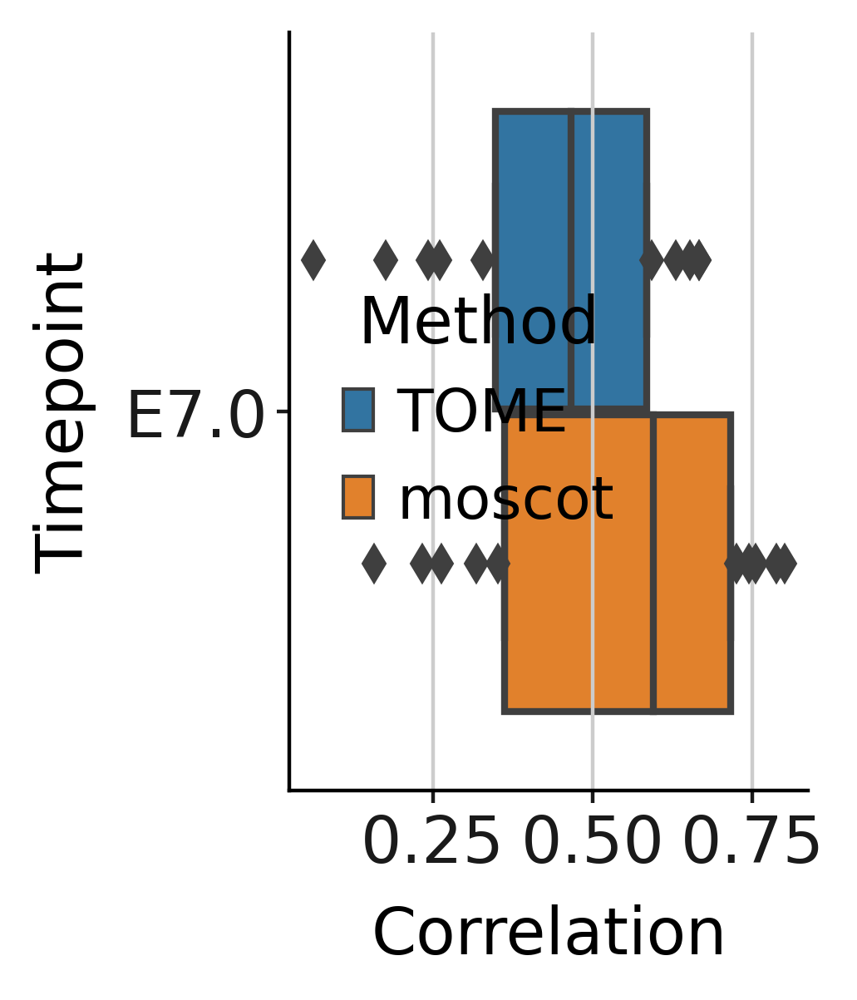

In [51]:
fig, ax = plt.subplots(ncols=1, figsize=(2, 3))
sns.boxplot(data=DF, x="Correlation", y="Timepoint", hue='Method',
               showmeans=False,  whis=[100,0], ax=ax)

In [52]:
adataS2=adataS[adataS.obsm['X_umap'][:,0]>-5].copy()

In [53]:
def umap_gene(adata, adataS, gene, perc=99.99, f=1, cmap='viridis'):
    loc=adataS.var.index.get_loc(gene)
    exp=adataS.layers['scvi_normalized'][:,loc]
    exp=exp/max(exp)*f
    
    adata.obs[f'{gene} expression']=exp
    
    vmax=max(adata.obs['Pull_Moscot'])*perc/100
    
    sc.pl.umap(adata, color=f'{gene} expression', title='', color_map=cmap, size=4, vmax=vmax, legend_loc=(0,0))
    
    #scv.pl.scatter(adata, color=f'{gene} expression', 
    #           basis='X_umap', size=16, figsize=(5,4), legend_loc=(0.8,0.7), 
    #           title='', fontsize=20, perc=(0,perc), dpi=1000, color_map=cmap,
    #          frameon=True)

In [54]:
mplscience.set_style(reset_current=True)
sc.set_figure_params(scanpy=True, dpi=200, frameon=False, vector_friendly=True, fontsize=14, 
                     figsize=(5,4), color_map=None)

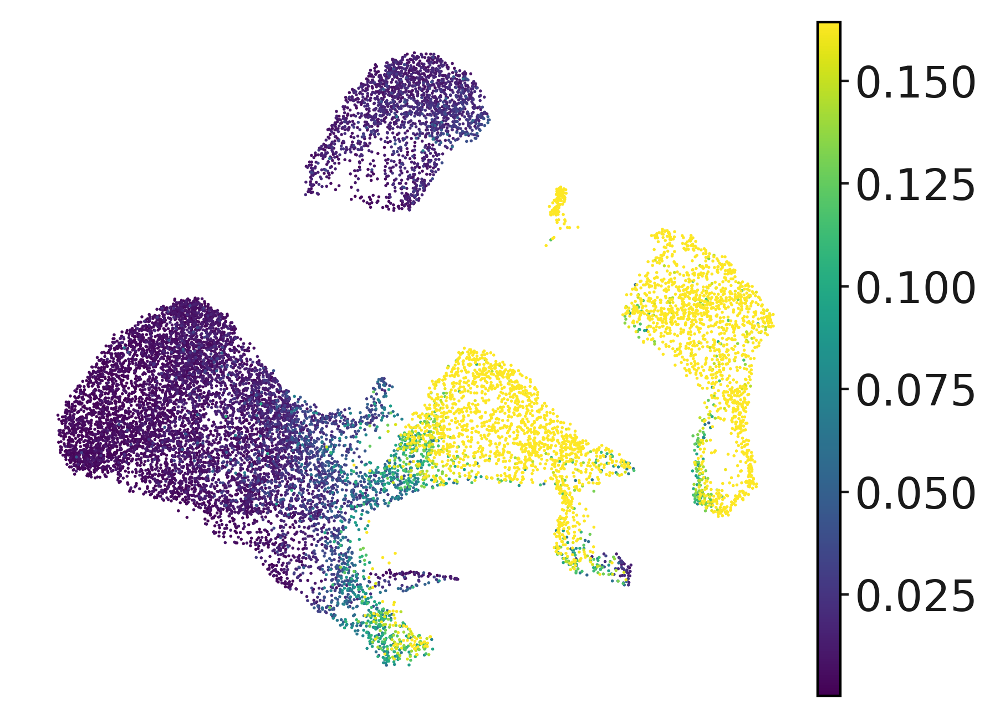

In [373]:
umap_gene(adata2[adata2.obs['day']==7], adataS2, 'Gata4', perc=1)

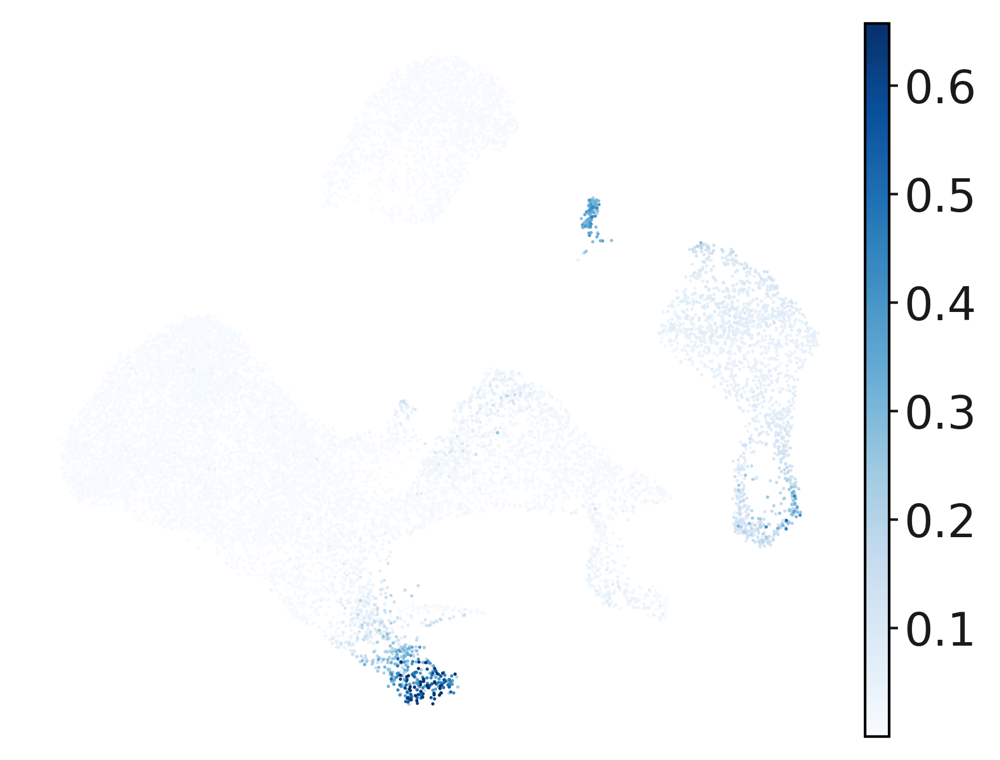

In [353]:
umap_gene(adata2[adata2.obs['day']==7], adataS2, 'Sox17', perc=4, cmap='Blues')

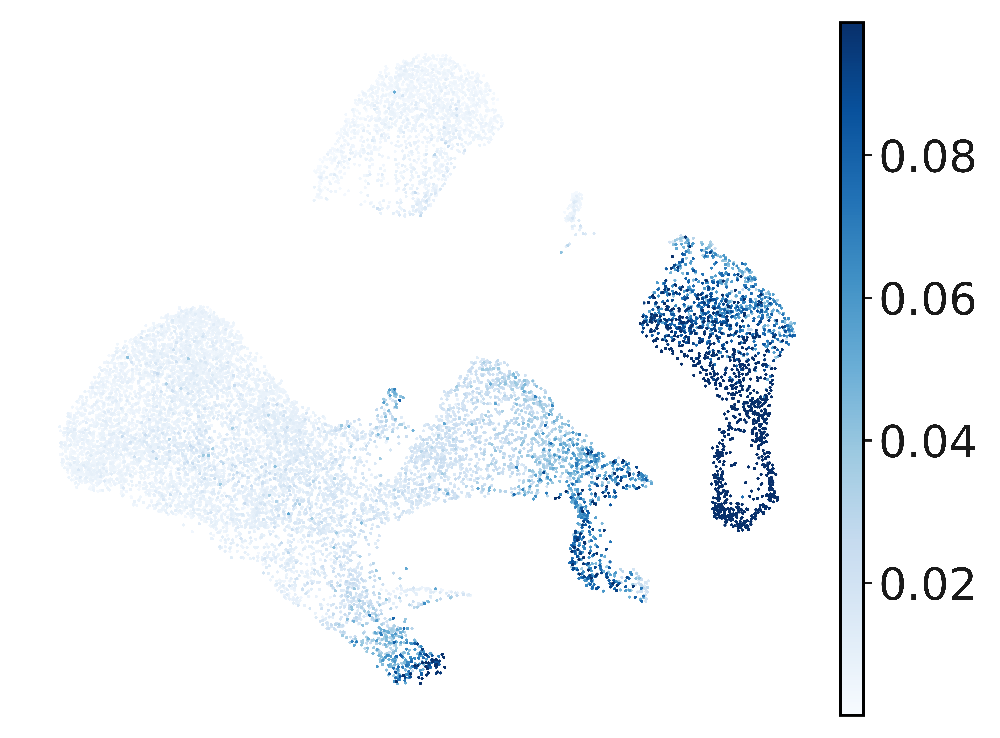

In [652]:
umap_gene(adata2[adata2.obs['day']==7], adataS2, 'Amot', perc=0.6, cmap='Blues')

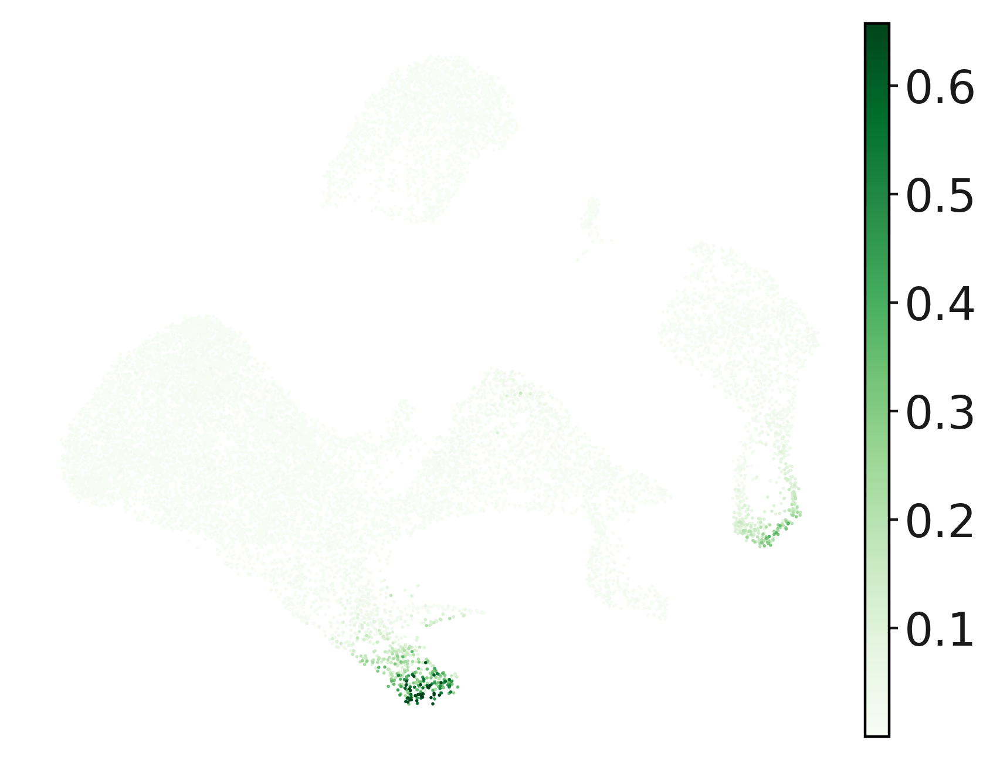

In [391]:
umap_gene(adata2[adata2.obs['day']==7], adataS2, 'Cer1', perc=4, cmap='Greens')

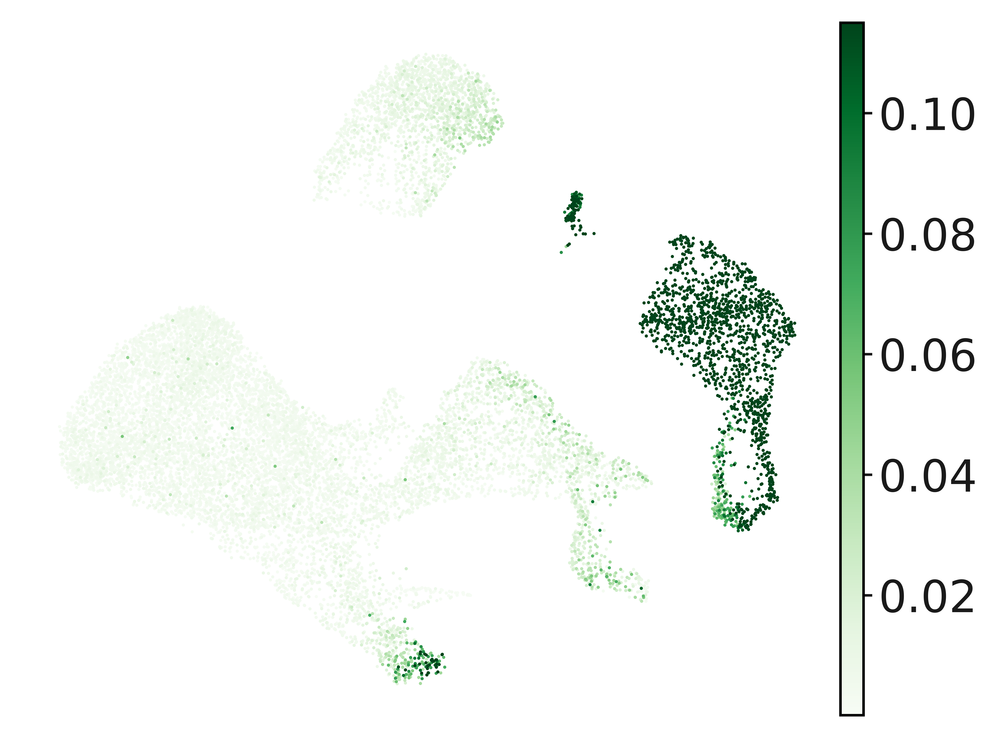

In [653]:
umap_gene(adata2[adata2.obs['day']==7], adataS2, 'Hnf1b', perc=0.7, cmap='Greens')

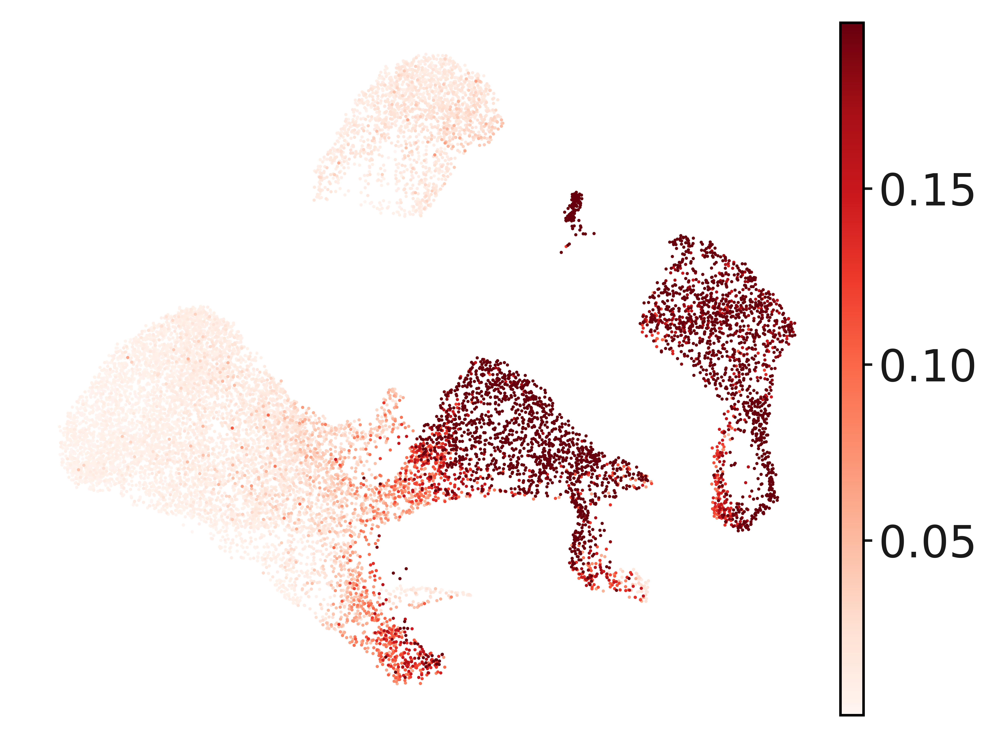

In [654]:
umap_gene(adata2[adata2.obs['day']==7], adataS2, 'Gata4', perc=1.2, cmap='Reds')

In [55]:
def col_map(v):
    r,g,b=v
    cdict2 = {'red':   [(0.0,  0, 0),
                       (1.0,  r,0)],
             'green': [(0.0,  0, 0),
                      (1.0,  g, 0)],
             'blue':  [(0.0,  0, 0.0),
                      (1.0,  b, 0)]} 
    my_cmap = matplotlib.colors.LinearSegmentedColormap('my_colormap2',cdict2,256)
    return(my_cmap)

In [56]:
def plt_cmap(cmap):
    plt.figure()
    a=np.outer(np.arange(0,1,0.01),np.ones(100))
    plt.imshow(a,aspect='auto', cmap =cmap)                   
    plt.show()

In [57]:
def col_dict(genes, k=-2):
    if gene=='Sox17':
        col=sns.color_palette('Blues')[k]
    elif gene=='Amot':
        col=sns.color_palette('Blues')[k]
    elif gene=='Cer1':
        col=sns.color_palette('Purples')[k]
    elif gene=='Hnf1b':
        col=sns.color_palette('Greens')[k]
    elif gene=='Gata4':
        col=sns.color_palette('Reds')[k]
    return(col)

In [58]:
np.array(sns.color_palette('Blues')[-1])*255

array([ 11.23529412,  85.14117647, 159.23529412])

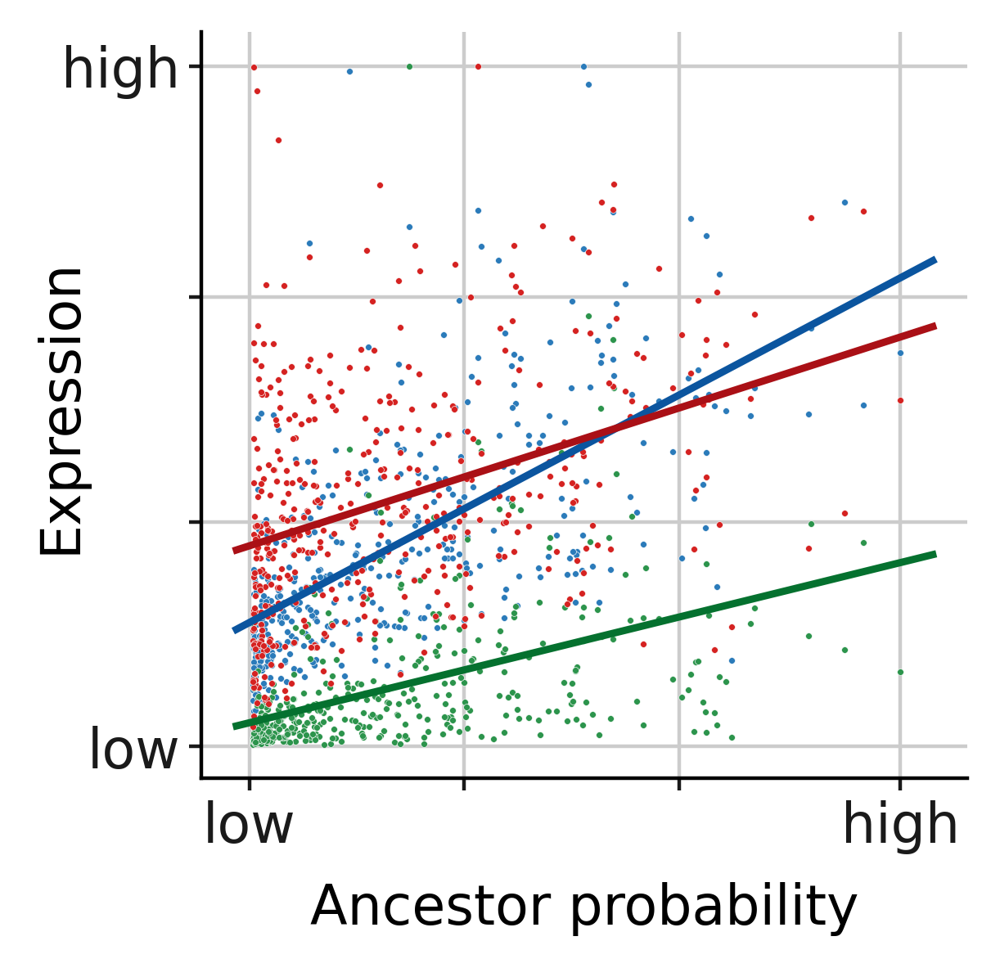

In [64]:
fontsize=12

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 3))

for gene in ['Amot', 'Hnf1b', 'Gata4']:
    ms=0.9
    cut=0.005
    
    loc=adataS.var.index.get_loc(gene)
    exp=adataS.layers['scvi_normalized'][:,loc]

    wh=np.where(adataS.obs['cell_state']=='E7:Anterior primitive streak')[0]
    exp=exp[wh]
    gM2=gM[wh]
    
    gM2=gM2/gM2.max()
    exp=exp/exp.max()
    
    wh=np.where(gM2>cut)[0]
    
    gM3=gM2[wh]
    exp=exp[wh]
    
    exp=exp/exp.max()
    
    col=col_dict(gene)

    sns.scatterplot(x=gM3, y=exp, color=col, s=2, zorder=2)
    
    a,b=np.polyfit(gM3, exp, 1)
    
    
    def lin(xs,a,b):
        l=[]
        for x in xs:
            l.append(b+a*x)
        return(l)

    xs=np.linspace(-0.02,1.05,101)
    y=lin(xs,a,b)
    
    plt.plot(xs, y, linewidth=1.6, color=col_dict(gene, k=-1), zorder=3)

    ax.set_ylabel(ylabel='Expression', fontsize=fontsize)
    plt.yticks([0,0.33,0.66,1])
    ax.set_yticklabels(labels=['low', '','', 'high'],fontsize=fontsize)

    ax.set_xlabel(xlabel='Ancestor probability', fontsize=fontsize)
    plt.xticks([0,0.33,.66,1])
    ax.set_xticklabels(labels=['low', '', '', 'high'],fontsize=fontsize)

    ax.yaxis.set_label_coords(-0.15, 0.5)

In [60]:
wh

array([  0,   1,   2,   3,   4,   7,   9,  10,  15,  16,  17,  19,  20,
        22,  23,  24,  29,  31,  32,  33,  34,  35,  37,  38,  39,  40,
        41,  42,  44,  49,  50,  51,  55,  56,  57,  59,  61,  62,  64,
        65,  66,  68,  69,  70,  71,  72,  73,  74,  75,  76,  78,  79,
        80,  81,  82,  84,  86,  88,  89,  91,  92,  94,  96,  97,  98,
        99, 102, 103, 104, 106, 107, 108, 109, 115, 116, 118, 119, 120,
       121, 123, 125, 126, 127, 128, 130, 132, 135, 136, 138, 139, 141,
       142, 144, 145, 146, 147, 149, 152, 153, 154, 156, 157, 159, 160,
       161, 162, 163, 164, 165, 166, 167, 169, 170, 171, 172, 173, 174,
       176, 178, 179, 180, 182, 184, 186, 187, 188, 189, 190, 191, 192,
       194, 195, 196, 197, 198, 199, 200, 201, 203, 204, 205, 206, 207,
       209, 210, 211, 215, 216, 218, 219, 227, 230, 237, 239, 240, 241,
       243, 244, 246, 250, 254, 255, 256, 258, 259, 260, 261, 262, 263,
       265, 268, 273, 274, 275, 276, 278, 280, 282, 283, 284, 28

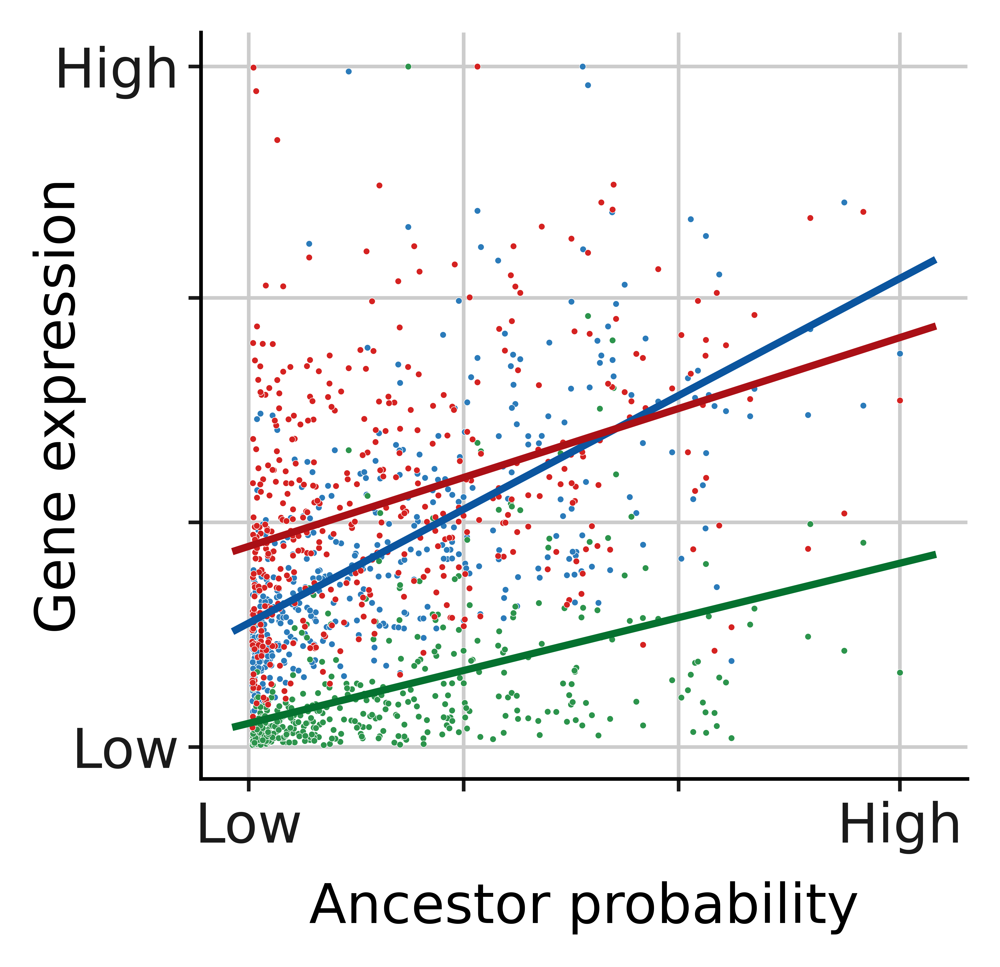

In [728]:
fontsize=12

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 3))

for gene in ['Amot', 'Hnf1b', 'Gata4']:
    ms=0.9
    cut=0.005
    
    loc=adataS.var.index.get_loc(gene)
    exp=adataS.layers['scvi_normalized'][:,loc]

    wh=np.where(adataS.obs['cell_state']=='E7:Anterior primitive streak')[0]
    exp=exp[wh]
    gM2=gM[wh]
    
    gM2=gM2/gM2.max()
    exp=exp/exp.max()
    
    wh=np.where(gM2>cut)[0]
    
    gM3=gM2[wh]
    exp=exp[wh]
    
    exp=exp/exp.max()
    
    col=col_dict(gene)

    sns.scatterplot(x=gM3, y=exp, color=col, s=2, zorder=2)
    
    a,b=np.polyfit(gM3, exp, 1)
    
    
    def lin(xs,a,b):
        l=[]
        for x in xs:
            l.append(b+a*x)
        return(l)

    xs=np.linspace(-0.02,1.05,101)
    y=lin(xs,a,b)
    
    plt.plot(xs, y, linewidth=1.6, color=col_dict(gene, k=-1), zorder=3)

    ax.set_ylabel(ylabel='Gene expression', fontsize=fontsize)
    plt.yticks([0,0.33,0.66,1])
    ax.set_yticklabels(labels=['Low', '','', 'High'],fontsize=fontsize)
    
    ax.set_xlabel(xlabel='Ancestor probability', fontsize=fontsize)
    plt.xticks([0,0.33,.66,1])
    ax.set_xticklabels(labels=['Low', '', '', 'High'],fontsize=fontsize)
    
    ax.yaxis.set_label_coords(-0.15, 0.5)

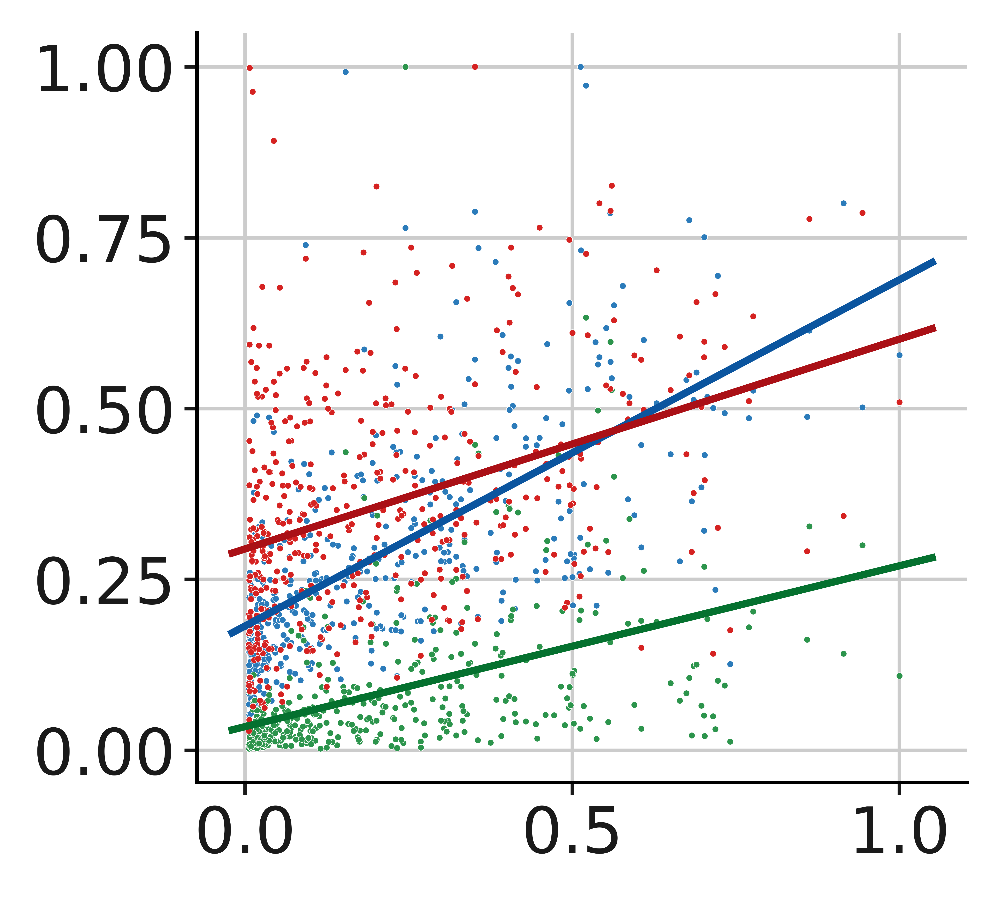

In [727]:
fontsize=12

import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 3))

for gene in ['Amot', 'Hnf1b', 'Gata4']:
    ms=0.9
    cut=0.005
    
    loc=adataS.var.index.get_loc(gene)
    exp=adataS.layers['scvi_normalized'][:,loc]

    wh=np.where(adataS.obs['cell_state']=='E7:Anterior primitive streak')[0]
    exp=exp[wh]
    gM2=gM[wh]
    
    gM2=gM2/gM2.max()
    exp=exp/exp.max()
    
    wh=np.where(gM2>cut)[0]
    
    gM3=gM2[wh]
    exp=exp[wh]
    
    exp=exp/exp.max()
    
    col=col_dict(gene)

    sns.scatterplot(x=gM3, y=exp, color=col, s=2, zorder=2)
    
    a,b=np.polyfit(gM3, exp, 1)
    
    
    def lin(xs,a,b):
        l=[]
        for x in xs:
            l.append(b+a*x)
        return(l)

    xs=np.linspace(-0.02,1.05,101)
    y=lin(xs,a,b)
    
    plt.plot(xs, y, linewidth=1.6, color=col_dict(gene, k=-1), zorder=3)
    ax.yaxis.set_label_coords(-0.15, 0.5)

<AxesSubplot:>

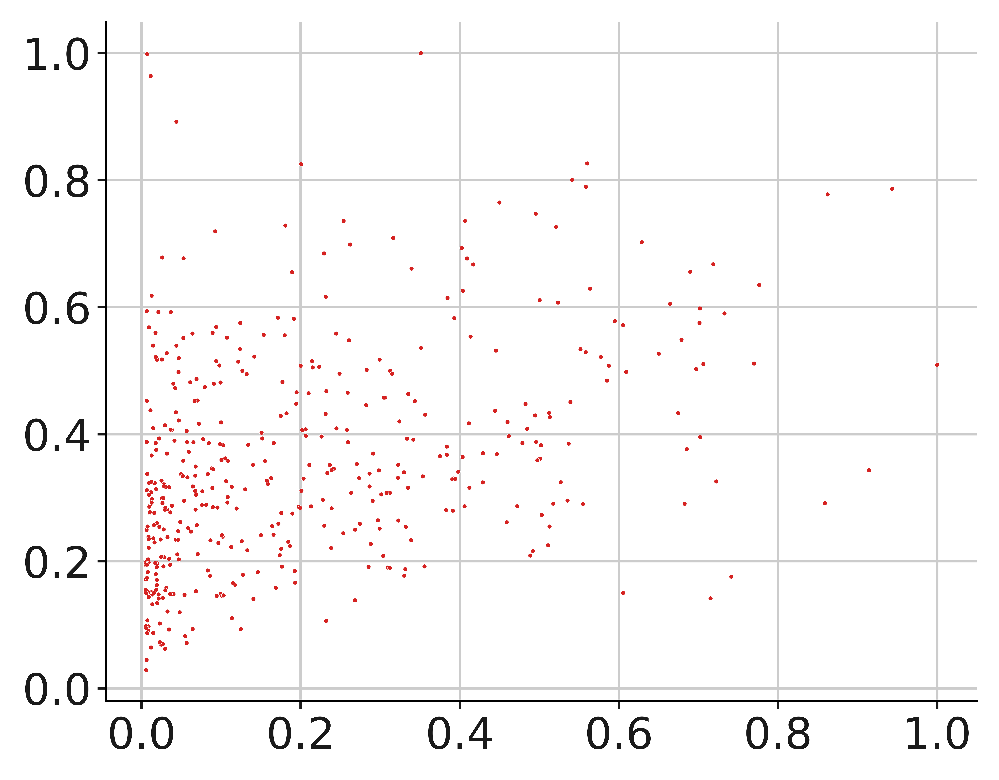

In [723]:
sns.scatterplot(x=gM3, y=exp, color=col, s=2, zorder=100)